<a href="https://colab.research.google.com/github/Thorkee/BIM/blob/main/BIM_feature_matching_ver3.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!git clone --quiet --recursive https://github.com/cvg/Hierarchical-Localization/
%cd Hierarchical-Localization
!pip install --progress-bar off --quiet -e .
!pip install --progress-bar off --quiet --upgrade plotly

import tqdm, tqdm.notebook
tqdm.tqdm = tqdm.notebook.tqdm  # notebook-friendly progress bars
from pathlib import Path

from hloc import extract_features, match_features, reconstruction, visualization, pairs_from_exhaustive
from hloc.visualization import plot_images, read_image
from hloc.utils import viz_3d

/content/Hierarchical-Localization
  Preparing metadata (setup.py) ... done
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done


In [41]:
import cv2
import numpy as np
import os

# Mount Google Drive
from google.colab import drive
drive.mount('/content/drive')

# Define input and output directories
input_dir = '/content/drive/MyDrive/Research/Journals/BIM/360'
output_dir = '/content/drive/MyDrive/PolyU/BIM Paper/query'

# Ensure the output directory exists
os.makedirs(output_dir, exist_ok=True)

# Function to extract a rectilinear view from an equirectangular image
def equirectangular_to_fov(image, fov=60, yaw=0, pitch=0, width=800, height=600):
    """
    Converts an equirectangular panoramic image into a rectilinear projection with a given FOV, yaw, and pitch.

    Parameters:
        image (numpy.ndarray): Input panoramic image in equirectangular format.
        fov (int): Field of view in degrees.
        yaw (float): Horizontal angle (yaw) in degrees.
        pitch (float): Vertical angle (pitch) in degrees.
        width (int): Output image width in pixels.
        height (int): Output image height in pixels.

    Returns:
        numpy.ndarray: Rectilinear projection image.
    """
    # Convert angles to radians
    fov_rad = np.deg2rad(fov)
    yaw_rad = np.deg2rad(yaw)
    pitch_rad = np.deg2rad(pitch)

    # Focal length calculation
    focal_length = (width / 2) / np.tan(fov_rad / 2)

    # Define a 3D grid for the output image
    x, y = np.meshgrid(np.arange(width), np.arange(height))
    x = (x - width / 2) / focal_length  # Normalize x to focal length
    y = (y - height / 2) / focal_length  # Normalize y to focal length
    z = np.ones_like(x)

    # Normalize the 3D grid
    norm = np.sqrt(x**2 + y**2 + z**2)
    x /= norm
    y /= norm
    z /= norm

    # Apply rotations for yaw and pitch
    Rx = np.array([
        [1, 0, 0],
        [0, np.cos(pitch_rad), -np.sin(pitch_rad)],
        [0, np.sin(pitch_rad), np.cos(pitch_rad)]
    ])
    Ry = np.array([
        [np.cos(yaw_rad), 0, np.sin(yaw_rad)],
        [0, 1, 0],
        [-np.sin(yaw_rad), 0, np.cos(yaw_rad)]
    ])
    R = Ry @ Rx  # Combined rotation (first pitch, then yaw)

    # Apply the rotation to the coordinates
    coords = R @ np.stack([x.ravel(), y.ravel(), z.ravel()], axis=0)
    coords = coords.reshape(3, height, width)

    # Convert 3D coordinates to spherical coordinates
    lon = np.arctan2(coords[0], coords[2])  # Longitude (yaw)
    lat = np.arcsin(coords[1])              # Latitude (pitch)

    # Map spherical coordinates to pixel coordinates in the equirectangular image
    equirect_width = image.shape[1]
    equirect_height = image.shape[0]
    u = (lon / (2 * np.pi) + 0.5) * equirect_width
    v = (lat / np.pi + 0.5) * equirect_height  # Adjusted from -lat to lat for upright orientation

    # Remap the input image to the output view
    u = u.astype(np.float32)
    v = v.astype(np.float32)
    rectilinear_image = cv2.remap(image, u, v, interpolation=cv2.INTER_LINEAR, borderMode=cv2.BORDER_WRAP)

    return rectilinear_image

# Process all images in the input directory
for filename in sorted(os.listdir(input_dir)):
    if filename.lower().endswith(('.jpg', '.jpeg', '.png')):  # Filter image files
        # Load the panoramic image
        pano_image_path = os.path.join(input_dir, filename)
        pano_image = cv2.imread(pano_image_path)

        if pano_image is None:
            print(f"Error loading image: {pano_image_path}")
            continue

        # Get the base name of the image (without extension)
        base_name = os.path.splitext(filename)[0]

        # Extract 60-degree FOV images at different yaw angles
        for yaw in range(0, 360, 30):  # Iterate over yaw angles (0°, 30°, 60°, ..., 330°)
            try:
                fov_image = equirectangular_to_fov(
                    pano_image,
                    fov=60,
                    yaw=yaw,
                    pitch=0,  # Keep pitch fixed at 0°
                    width=800,
                    height=600
                )

                # Define the output file name
                output_filename = f"{base_name}_{yaw}.jpg"
                output_path = os.path.join(output_dir, output_filename)

                # Save the FOV image
                cv2.imwrite(output_path, fov_image)

            except Exception as e:
                print(f"Error processing {filename} at yaw={yaw}: {e}")

        print(f"Processed {filename} into multiple 60-degree FOV images.")

print("All images processed and saved.")

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Processed 1.jpg into multiple 60-degree FOV images.
Processed 10.jpg into multiple 60-degree FOV images.
Processed 2.jpg into multiple 60-degree FOV images.
Processed 3.jpg into multiple 60-degree FOV images.
Processed 4.jpg into multiple 60-degree FOV images.
Processed 5.jpg into multiple 60-degree FOV images.
Processed 6.jpg into multiple 60-degree FOV images.
Processed 7.jpg into multiple 60-degree FOV images.
Processed 8.jpg into multiple 60-degree FOV images.
Processed 9.jpg into multiple 60-degree FOV images.
All images processed and saved.


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
images = Path('/content/drive/MyDrive/PolyU/BIM Paper')
outputs = Path('/content/drive/MyDrive/PolyU/BIM Paper/outputs_resized')
!rm -rf $outputs
sfm_pairs = outputs / 'pairs-sfm.txt'
loc_pairs = outputs / 'pairs-loc.txt'
sfm_dir = outputs / 'sfm'
features = outputs / 'features.h5'
matches = outputs / 'matches.h5'

feature_conf = extract_features.confs['disk']
matcher_conf = match_features.confs['disk+lightglue']

# 3D mapping

307 mapping images


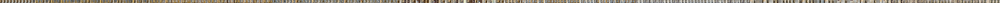

In [ ]:
references = [str(p.relative_to(images)) for p in (images / 'Cameraresized/').iterdir()]
print(len(references), "mapping images")
plot_images([read_image(images / r) for r in references], dpi=25)

In [ ]:
extract_features.main(feature_conf, images, image_list=references, feature_path=features)
pairs_from_exhaustive.main(sfm_pairs, image_list=references)
match_features.main(matcher_conf, sfm_pairs, features=features, matches=matches);

[2024/11/27 13:29:32 hloc INFO] Extracting local features with configuration:
{'model': {'max_keypoints': 5000, 'name': 'disk'},
 'output': 'feats-disk',
 'preprocessing': {'grayscale': False, 'resize_max': 1600}}


  0%|          | 0/307 [00:00<?, ?it/s]

[2024/11/27 13:30:04 hloc INFO] Finished exporting features.
[2024/11/27 13:30:04 hloc INFO] Found 46971 pairs.
[2024/11/27 13:30:04 hloc INFO] Matching local features with configuration:
{'model': {'features': 'disk', 'name': 'lightglue'},
 'output': 'matches-disk-lightglue'}


  0%|          | 0/46971 [00:00<?, ?it/s]

[2024/11/27 14:19:15 hloc INFO] Finished exporting matches.


In [ ]:
model = reconstruction.main(sfm_dir, images, sfm_pairs, features, matches, image_list=references)

[2024/11/27 14:25:44 hloc INFO] Creating an empty database...
[2024/11/27 14:25:44 hloc INFO] Importing images into the database...
[2024/11/27 14:25:53 hloc INFO] Importing features into the database...


  0%|          | 0/307 [00:00<?, ?it/s]

[2024/11/27 14:25:55 hloc INFO] Importing matches into the database...


  0%|          | 0/46971 [00:00<?, ?it/s]

[2024/11/27 14:51:50 hloc INFO] Performing geometric verification of the matches...
[2024/11/27 14:53:14 hloc INFO] Running 3D reconstruction...
[2024/11/27 16:08:40 hloc INFO] Reconstructed 3 model(s).
[2024/11/27 16:08:40 hloc INFO] Largest model is #1 with 273 images.
[2024/11/27 16:08:40 hloc INFO] Reconstruction statistics:
Reconstruction:
	num_reg_images = 273
	num_cameras = 273
	num_points3D = 114403
	num_observations = 685954
	mean_track_length = 5.99594
	mean_observations_per_image = 2512.65
	mean_reprojection_error = 1.38072
	num_input_images = 307


and display the reconstructed 3D model:

In [ ]:
fig = viz_3d.init_figure()
viz_3d.plot_reconstruction(fig, model, color='rgba(255,0,0,0.5)', name="mapping", points_rgb=True)
fig.show()

# Localization

wget: missing URL
Usage: wget [OPTION]... [URL]...

Try `wget --help' for more options.


[2024/11/27 17:05:07 hloc INFO] Extracting local features with configuration:
{'model': {'max_keypoints': 5000, 'name': 'disk'},
 'output': 'feats-disk',
 'preprocessing': {'grayscale': False, 'resize_max': 1600}}


  0%|          | 0/1 [00:00<?, ?it/s]

[2024/11/27 17:05:08 hloc INFO] Finished exporting features.
[2024/11/27 17:05:08 hloc INFO] Found 273 pairs.
[2024/11/27 17:05:08 hloc INFO] Matching local features with configuration:
{'model': {'features': 'disk', 'name': 'lightglue'},
 'output': 'matches-disk-lightglue'}


  0%|          | 0/273 [00:00<?, ?it/s]

[2024/11/27 17:05:21 hloc INFO] Finished exporting matches.


found 6770/11134 inlier correspondences.


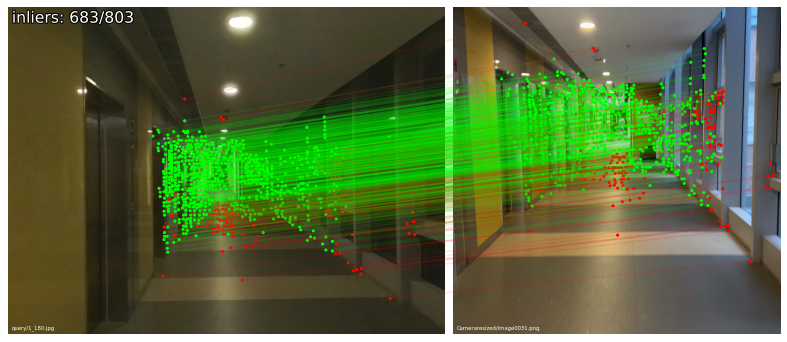

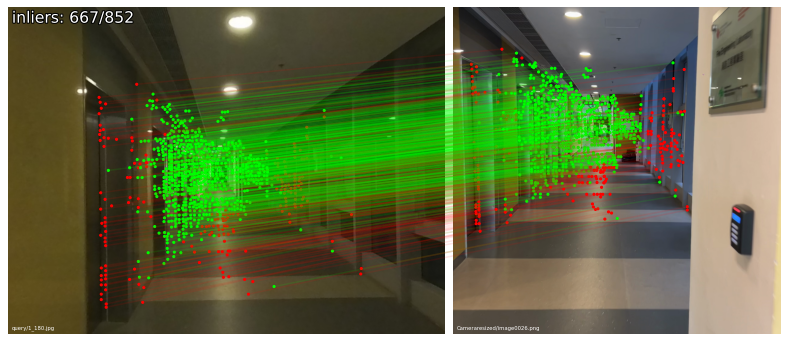

In [37]:
query = 'query/1_180.jpg'
!mkdir -p $images/query && wget $url -O $images/$query -q
# plot_images([read_image(images / query)], dpi=75)

references_registered = [model.images[i].name for i in model.reg_image_ids()]
extract_features.main(feature_conf, images, image_list=[query], feature_path=features, overwrite=True)
pairs_from_exhaustive.main(loc_pairs, image_list=[query], ref_list=references_registered)
match_features.main(matcher_conf, loc_pairs, features=features, matches=matches, overwrite=True);

import pycolmap
from hloc.localize_sfm import QueryLocalizer, pose_from_cluster

camera = pycolmap.infer_camera_from_image(images / query)
ref_ids = [model.find_image_with_name(n).image_id for n in references_registered]
conf = {
    'estimation': {'ransac': {'max_error': 12}},
    'refinement': {'refine_focal_length': True, 'refine_extra_params': True},
}
localizer = QueryLocalizer(model, conf)
ret, log = pose_from_cluster(localizer, query, camera, ref_ids, features, matches)

print(f'found {ret["num_inliers"]}/{len(ret["inliers"])} inlier correspondences.')
visualization.visualize_loc_from_log(images, query, log, model)

wget: missing URL
Usage: wget [OPTION]... [URL]...

Try `wget --help' for more options.


[2024/11/27 17:06:30 hloc INFO] Extracting local features with configuration:
{'model': {'max_keypoints': 5000, 'name': 'disk'},
 'output': 'feats-disk',
 'preprocessing': {'grayscale': False, 'resize_max': 1600}}


  0%|          | 0/1 [00:00<?, ?it/s]

[2024/11/27 17:06:31 hloc INFO] Finished exporting features.
[2024/11/27 17:06:31 hloc INFO] Found 273 pairs.
[2024/11/27 17:06:31 hloc INFO] Matching local features with configuration:
{'model': {'features': 'disk', 'name': 'lightglue'},
 'output': 'matches-disk-lightglue'}


  0%|          | 0/273 [00:00<?, ?it/s]

[2024/11/27 17:06:44 hloc INFO] Finished exporting matches.


found 3432/11484 inlier correspondences.


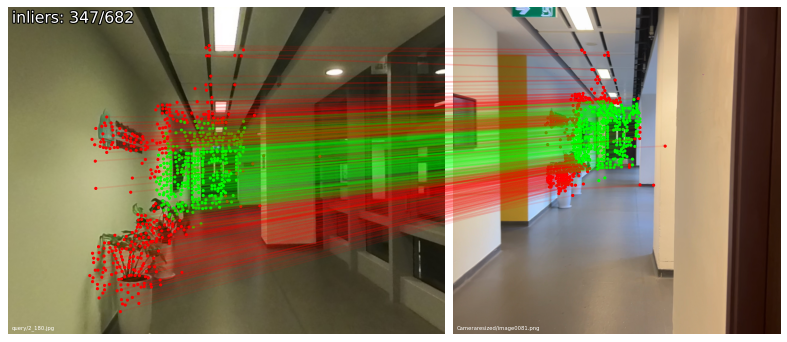

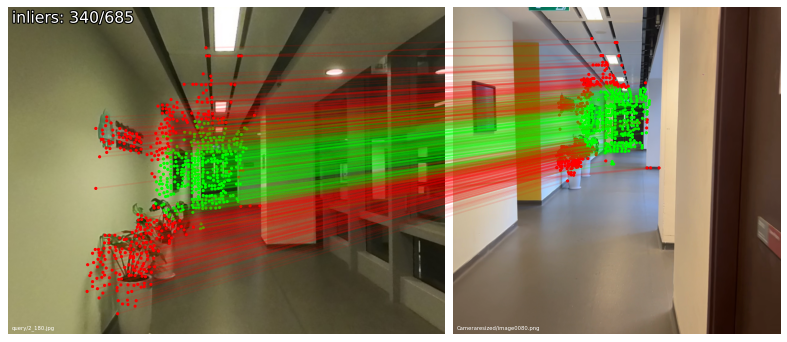

In [38]:
query = 'query/2_180.jpg'
!mkdir -p $images/query && wget $url -O $images/$query -q
# plot_images([read_image(images / query)], dpi=75)

references_registered = [model.images[i].name for i in model.reg_image_ids()]
extract_features.main(feature_conf, images, image_list=[query], feature_path=features, overwrite=True)
pairs_from_exhaustive.main(loc_pairs, image_list=[query], ref_list=references_registered)
match_features.main(matcher_conf, loc_pairs, features=features, matches=matches, overwrite=True);

import pycolmap
from hloc.localize_sfm import QueryLocalizer, pose_from_cluster

camera = pycolmap.infer_camera_from_image(images / query)
ref_ids = [model.find_image_with_name(n).image_id for n in references_registered]
conf = {
    'estimation': {'ransac': {'max_error': 12}},
    'refinement': {'refine_focal_length': True, 'refine_extra_params': True},
}
localizer = QueryLocalizer(model, conf)
ret, log = pose_from_cluster(localizer, query, camera, ref_ids, features, matches)

print(f'found {ret["num_inliers"]}/{len(ret["inliers"])} inlier correspondences.')
visualization.visualize_loc_from_log(images, query, log, model)

wget: missing URL
Usage: wget [OPTION]... [URL]...

Try `wget --help' for more options.


[2024/11/27 17:07:50 hloc INFO] Extracting local features with configuration:
{'model': {'max_keypoints': 5000, 'name': 'disk'},
 'output': 'feats-disk',
 'preprocessing': {'grayscale': False, 'resize_max': 1600}}


  0%|          | 0/1 [00:00<?, ?it/s]

[2024/11/27 17:07:51 hloc INFO] Finished exporting features.
[2024/11/27 17:07:51 hloc INFO] Found 273 pairs.
[2024/11/27 17:07:51 hloc INFO] Matching local features with configuration:
{'model': {'features': 'disk', 'name': 'lightglue'},
 'output': 'matches-disk-lightglue'}


  0%|          | 0/273 [00:00<?, ?it/s]

[2024/11/27 17:08:02 hloc INFO] Finished exporting matches.


found 503/2461 inlier correspondences.


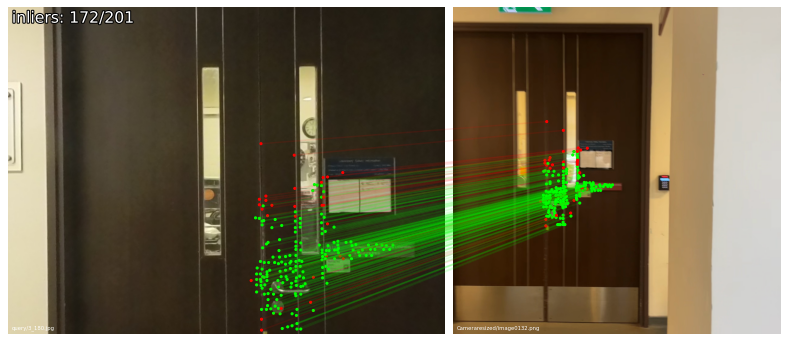

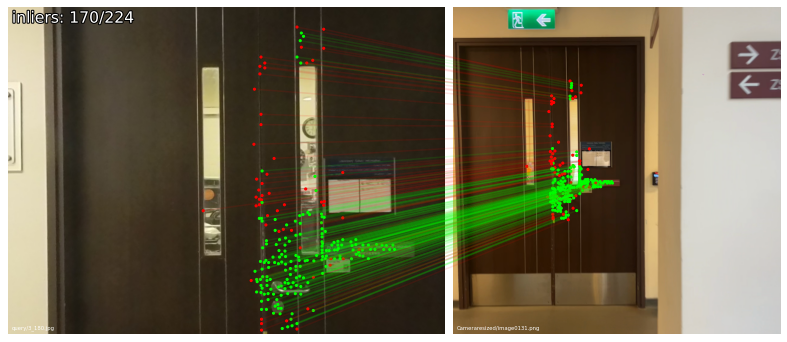

In [39]:
query = 'query/3_180.jpg'
!mkdir -p $images/query && wget $url -O $images/$query -q
# plot_images([read_image(images / query)], dpi=75)

references_registered = [model.images[i].name for i in model.reg_image_ids()]
extract_features.main(feature_conf, images, image_list=[query], feature_path=features, overwrite=True)
pairs_from_exhaustive.main(loc_pairs, image_list=[query], ref_list=references_registered)
match_features.main(matcher_conf, loc_pairs, features=features, matches=matches, overwrite=True);

import pycolmap
from hloc.localize_sfm import QueryLocalizer, pose_from_cluster

camera = pycolmap.infer_camera_from_image(images / query)
ref_ids = [model.find_image_with_name(n).image_id for n in references_registered]
conf = {
    'estimation': {'ransac': {'max_error': 12}},
    'refinement': {'refine_focal_length': True, 'refine_extra_params': True},
}
localizer = QueryLocalizer(model, conf)
ret, log = pose_from_cluster(localizer, query, camera, ref_ids, features, matches)

print(f'found {ret["num_inliers"]}/{len(ret["inliers"])} inlier correspondences.')
visualization.visualize_loc_from_log(images, query, log, model)

wget: missing URL
Usage: wget [OPTION]... [URL]...

Try `wget --help' for more options.


[2024/11/27 17:11:20 hloc INFO] Extracting local features with configuration:
{'model': {'max_keypoints': 5000, 'name': 'disk'},
 'output': 'feats-disk',
 'preprocessing': {'grayscale': False, 'resize_max': 1600}}


  0%|          | 0/1 [00:00<?, ?it/s]

[2024/11/27 17:11:21 hloc INFO] Finished exporting features.
[2024/11/27 17:11:21 hloc INFO] Found 273 pairs.
[2024/11/27 17:11:21 hloc INFO] Matching local features with configuration:
{'model': {'features': 'disk', 'name': 'lightglue'},
 'output': 'matches-disk-lightglue'}


  0%|          | 0/273 [00:00<?, ?it/s]

[2024/11/27 17:11:34 hloc INFO] Finished exporting matches.


found 1083/9970 inlier correspondences.


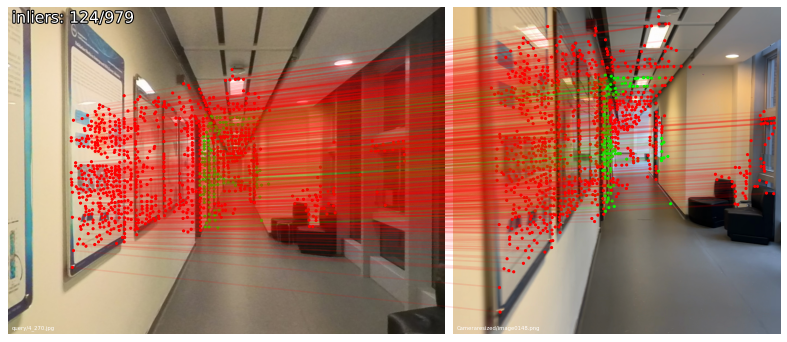

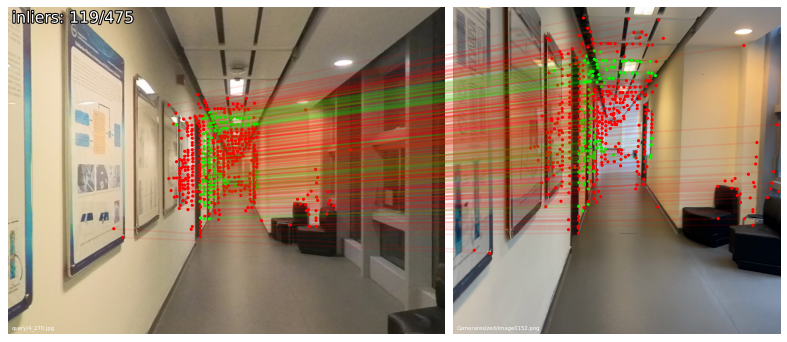

In [42]:
query = 'query/4_270.jpg'
!mkdir -p $images/query && wget $url -O $images/$query -q
# plot_images([read_image(images / query)], dpi=75)

references_registered = [model.images[i].name for i in model.reg_image_ids()]
extract_features.main(feature_conf, images, image_list=[query], feature_path=features, overwrite=True)
pairs_from_exhaustive.main(loc_pairs, image_list=[query], ref_list=references_registered)
match_features.main(matcher_conf, loc_pairs, features=features, matches=matches, overwrite=True);

import pycolmap
from hloc.localize_sfm import QueryLocalizer, pose_from_cluster

camera = pycolmap.infer_camera_from_image(images / query)
ref_ids = [model.find_image_with_name(n).image_id for n in references_registered]
conf = {
    'estimation': {'ransac': {'max_error': 12}},
    'refinement': {'refine_focal_length': True, 'refine_extra_params': True},
}
localizer = QueryLocalizer(model, conf)
ret, log = pose_from_cluster(localizer, query, camera, ref_ids, features, matches)

print(f'found {ret["num_inliers"]}/{len(ret["inliers"])} inlier correspondences.')
visualization.visualize_loc_from_log(images, query, log, model)

wget: missing URL
Usage: wget [OPTION]... [URL]...

Try `wget --help' for more options.


[2024/11/27 17:12:09 hloc INFO] Extracting local features with configuration:
{'model': {'max_keypoints': 5000, 'name': 'disk'},
 'output': 'feats-disk',
 'preprocessing': {'grayscale': False, 'resize_max': 1600}}


  0%|          | 0/1 [00:00<?, ?it/s]

[2024/11/27 17:12:10 hloc INFO] Finished exporting features.
[2024/11/27 17:12:10 hloc INFO] Found 273 pairs.
[2024/11/27 17:12:10 hloc INFO] Matching local features with configuration:
{'model': {'features': 'disk', 'name': 'lightglue'},
 'output': 'matches-disk-lightglue'}


  0%|          | 0/273 [00:00<?, ?it/s]

[2024/11/27 17:12:23 hloc INFO] Finished exporting matches.


found 1995/9259 inlier correspondences.


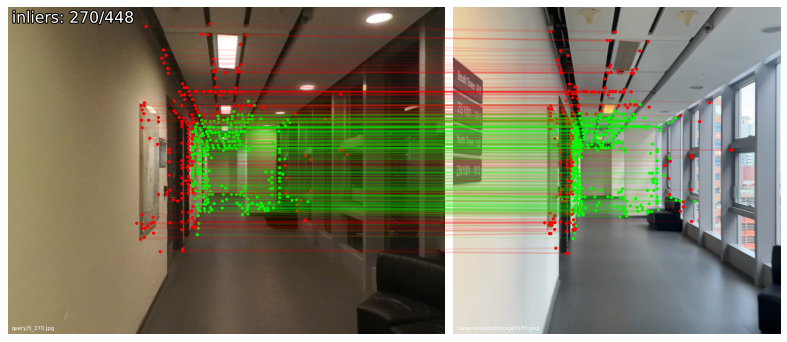

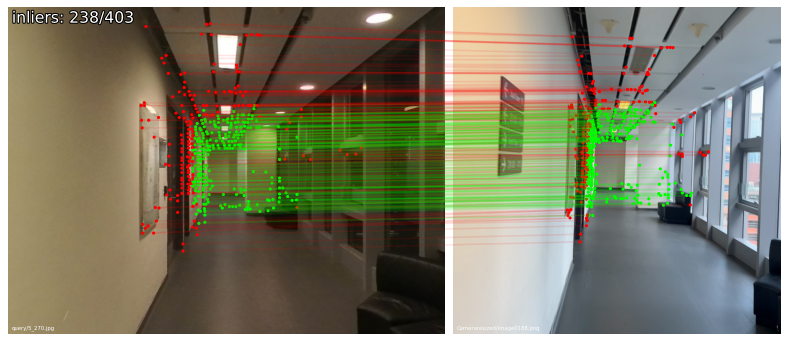

In [43]:
query = 'query/5_270.jpg'
!mkdir -p $images/query && wget $url -O $images/$query -q
# plot_images([read_image(images / query)], dpi=75)

references_registered = [model.images[i].name for i in model.reg_image_ids()]
extract_features.main(feature_conf, images, image_list=[query], feature_path=features, overwrite=True)
pairs_from_exhaustive.main(loc_pairs, image_list=[query], ref_list=references_registered)
match_features.main(matcher_conf, loc_pairs, features=features, matches=matches, overwrite=True);

import pycolmap
from hloc.localize_sfm import QueryLocalizer, pose_from_cluster

camera = pycolmap.infer_camera_from_image(images / query)
ref_ids = [model.find_image_with_name(n).image_id for n in references_registered]
conf = {
    'estimation': {'ransac': {'max_error': 12}},
    'refinement': {'refine_focal_length': True, 'refine_extra_params': True},
}
localizer = QueryLocalizer(model, conf)
ret, log = pose_from_cluster(localizer, query, camera, ref_ids, features, matches)

print(f'found {ret["num_inliers"]}/{len(ret["inliers"])} inlier correspondences.')
visualization.visualize_loc_from_log(images, query, log, model)

wget: missing URL
Usage: wget [OPTION]... [URL]...

Try `wget --help' for more options.


[2024/11/27 17:12:48 hloc INFO] Extracting local features with configuration:
{'model': {'max_keypoints': 5000, 'name': 'disk'},
 'output': 'feats-disk',
 'preprocessing': {'grayscale': False, 'resize_max': 1600}}


  0%|          | 0/1 [00:00<?, ?it/s]

[2024/11/27 17:12:49 hloc INFO] Finished exporting features.
[2024/11/27 17:12:49 hloc INFO] Found 273 pairs.
[2024/11/27 17:12:49 hloc INFO] Matching local features with configuration:
{'model': {'features': 'disk', 'name': 'lightglue'},
 'output': 'matches-disk-lightglue'}


  0%|          | 0/273 [00:00<?, ?it/s]

[2024/11/27 17:13:01 hloc INFO] Finished exporting matches.


found 295/3212 inlier correspondences.


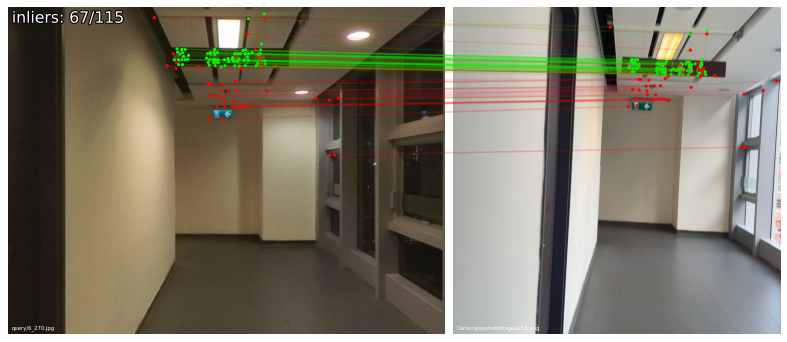

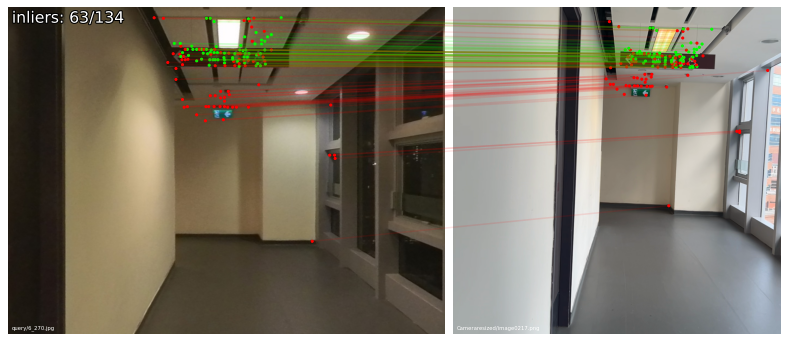

In [44]:
query = 'query/6_270.jpg'
!mkdir -p $images/query && wget $url -O $images/$query -q
# plot_images([read_image(images / query)], dpi=75)

references_registered = [model.images[i].name for i in model.reg_image_ids()]
extract_features.main(feature_conf, images, image_list=[query], feature_path=features, overwrite=True)
pairs_from_exhaustive.main(loc_pairs, image_list=[query], ref_list=references_registered)
match_features.main(matcher_conf, loc_pairs, features=features, matches=matches, overwrite=True);

import pycolmap
from hloc.localize_sfm import QueryLocalizer, pose_from_cluster

camera = pycolmap.infer_camera_from_image(images / query)
ref_ids = [model.find_image_with_name(n).image_id for n in references_registered]
conf = {
    'estimation': {'ransac': {'max_error': 12}},
    'refinement': {'refine_focal_length': True, 'refine_extra_params': True},
}
localizer = QueryLocalizer(model, conf)
ret, log = pose_from_cluster(localizer, query, camera, ref_ids, features, matches)

print(f'found {ret["num_inliers"]}/{len(ret["inliers"])} inlier correspondences.')
visualization.visualize_loc_from_log(images, query, log, model)

wget: missing URL
Usage: wget [OPTION]... [URL]...

Try `wget --help' for more options.


[2024/11/27 17:13:54 hloc INFO] Extracting local features with configuration:
{'model': {'max_keypoints': 5000, 'name': 'disk'},
 'output': 'feats-disk',
 'preprocessing': {'grayscale': False, 'resize_max': 1600}}


  0%|          | 0/1 [00:00<?, ?it/s]

[2024/11/27 17:13:55 hloc INFO] Finished exporting features.
[2024/11/27 17:13:55 hloc INFO] Found 273 pairs.
[2024/11/27 17:13:55 hloc INFO] Matching local features with configuration:
{'model': {'features': 'disk', 'name': 'lightglue'},
 'output': 'matches-disk-lightglue'}


  0%|          | 0/273 [00:00<?, ?it/s]

[2024/11/27 17:14:08 hloc INFO] Finished exporting matches.


found 1060/6505 inlier correspondences.


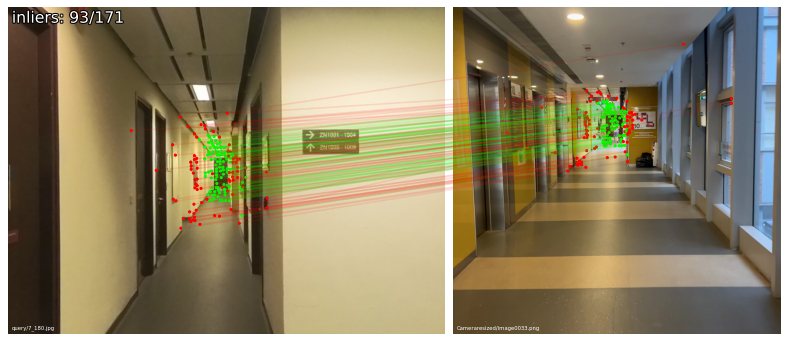

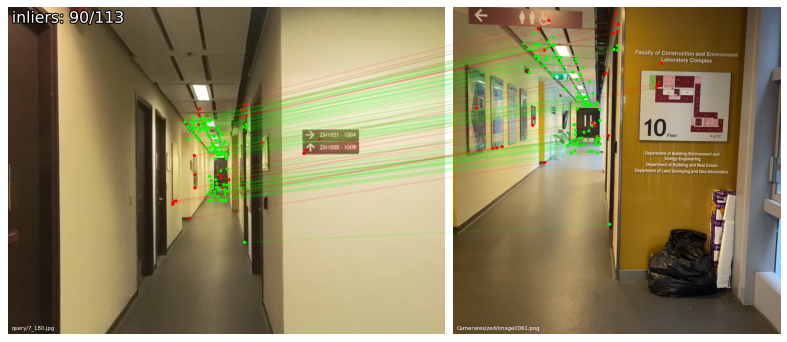

In [46]:
query = 'query/7_180.jpg'
!mkdir -p $images/query && wget $url -O $images/$query -q
# plot_images([read_image(images / query)], dpi=75)

references_registered = [model.images[i].name for i in model.reg_image_ids()]
extract_features.main(feature_conf, images, image_list=[query], feature_path=features, overwrite=True)
pairs_from_exhaustive.main(loc_pairs, image_list=[query], ref_list=references_registered)
match_features.main(matcher_conf, loc_pairs, features=features, matches=matches, overwrite=True);

import pycolmap
from hloc.localize_sfm import QueryLocalizer, pose_from_cluster

camera = pycolmap.infer_camera_from_image(images / query)
ref_ids = [model.find_image_with_name(n).image_id for n in references_registered]
conf = {
    'estimation': {'ransac': {'max_error': 12}},
    'refinement': {'refine_focal_length': True, 'refine_extra_params': True},
}
localizer = QueryLocalizer(model, conf)
ret, log = pose_from_cluster(localizer, query, camera, ref_ids, features, matches)

print(f'found {ret["num_inliers"]}/{len(ret["inliers"])} inlier correspondences.')
visualization.visualize_loc_from_log(images, query, log, model)

wget: missing URL
Usage: wget [OPTION]... [URL]...

Try `wget --help' for more options.


[2024/11/27 17:16:32 hloc INFO] Extracting local features with configuration:
{'model': {'max_keypoints': 5000, 'name': 'disk'},
 'output': 'feats-disk',
 'preprocessing': {'grayscale': False, 'resize_max': 1600}}


  0%|          | 0/1 [00:00<?, ?it/s]

[2024/11/27 17:16:33 hloc INFO] Finished exporting features.
[2024/11/27 17:16:33 hloc INFO] Found 273 pairs.
[2024/11/27 17:16:33 hloc INFO] Matching local features with configuration:
{'model': {'features': 'disk', 'name': 'lightglue'},
 'output': 'matches-disk-lightglue'}


  0%|          | 0/273 [00:00<?, ?it/s]

[2024/11/27 17:16:43 hloc INFO] Finished exporting matches.


found 353/2448 inlier correspondences.


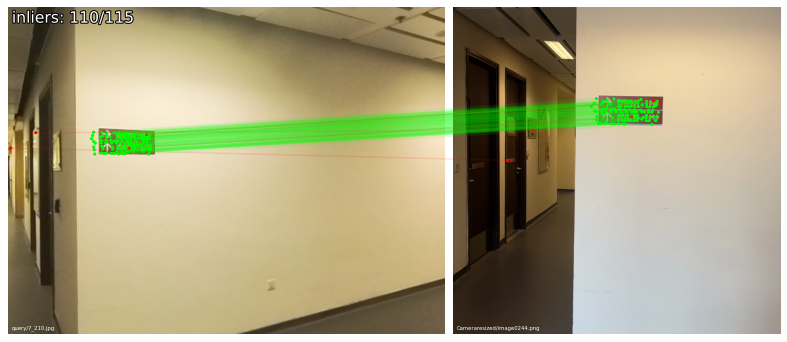

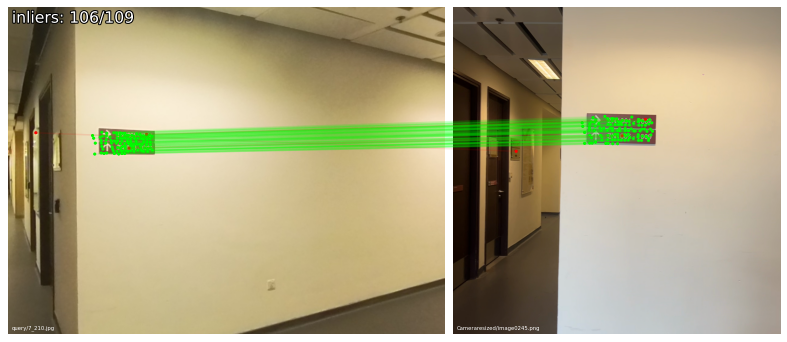

In [49]:
query = 'query/7_210.jpg'
!mkdir -p $images/query && wget $url -O $images/$query -q
# plot_images([read_image(images / query)], dpi=75)

references_registered = [model.images[i].name for i in model.reg_image_ids()]
extract_features.main(feature_conf, images, image_list=[query], feature_path=features, overwrite=True)
pairs_from_exhaustive.main(loc_pairs, image_list=[query], ref_list=references_registered)
match_features.main(matcher_conf, loc_pairs, features=features, matches=matches, overwrite=True);

import pycolmap
from hloc.localize_sfm import QueryLocalizer, pose_from_cluster

camera = pycolmap.infer_camera_from_image(images / query)
ref_ids = [model.find_image_with_name(n).image_id for n in references_registered]
conf = {
    'estimation': {'ransac': {'max_error': 12}},
    'refinement': {'refine_focal_length': True, 'refine_extra_params': True},
}
localizer = QueryLocalizer(model, conf)
ret, log = pose_from_cluster(localizer, query, camera, ref_ids, features, matches)

print(f'found {ret["num_inliers"]}/{len(ret["inliers"])} inlier correspondences.')
visualization.visualize_loc_from_log(images, query, log, model)

wget: missing URL
Usage: wget [OPTION]... [URL]...

Try `wget --help' for more options.


[2024/11/27 17:17:42 hloc INFO] Extracting local features with configuration:
{'model': {'max_keypoints': 5000, 'name': 'disk'},
 'output': 'feats-disk',
 'preprocessing': {'grayscale': False, 'resize_max': 1600}}


  0%|          | 0/1 [00:00<?, ?it/s]

[2024/11/27 17:17:42 hloc INFO] Finished exporting features.
[2024/11/27 17:17:42 hloc INFO] Found 273 pairs.
[2024/11/27 17:17:42 hloc INFO] Matching local features with configuration:
{'model': {'features': 'disk', 'name': 'lightglue'},
 'output': 'matches-disk-lightglue'}


  0%|          | 0/273 [00:00<?, ?it/s]

[2024/11/27 17:17:54 hloc INFO] Finished exporting matches.


found 556/4086 inlier correspondences.


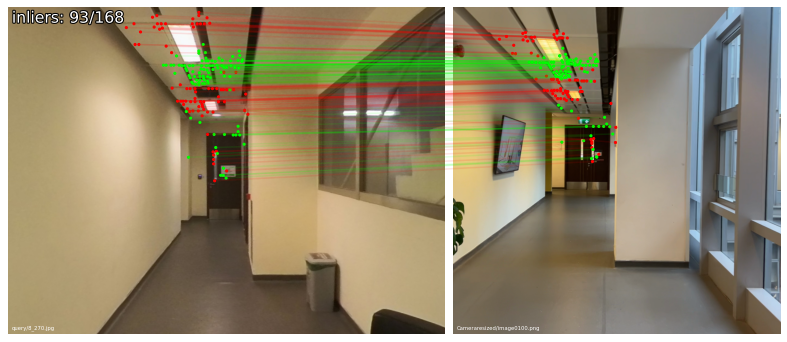

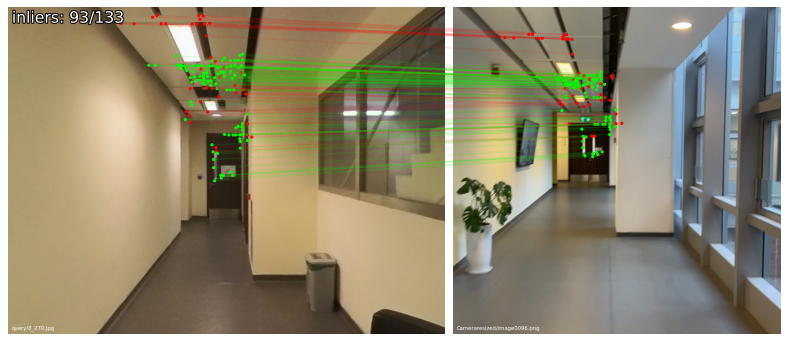

In [51]:
query = 'query/8_270.jpg'
!mkdir -p $images/query && wget $url -O $images/$query -q
# plot_images([read_image(images / query)], dpi=75)

references_registered = [model.images[i].name for i in model.reg_image_ids()]
extract_features.main(feature_conf, images, image_list=[query], feature_path=features, overwrite=True)
pairs_from_exhaustive.main(loc_pairs, image_list=[query], ref_list=references_registered)
match_features.main(matcher_conf, loc_pairs, features=features, matches=matches, overwrite=True);

import pycolmap
from hloc.localize_sfm import QueryLocalizer, pose_from_cluster

camera = pycolmap.infer_camera_from_image(images / query)
ref_ids = [model.find_image_with_name(n).image_id for n in references_registered]
conf = {
    'estimation': {'ransac': {'max_error': 12}},
    'refinement': {'refine_focal_length': True, 'refine_extra_params': True},
}
localizer = QueryLocalizer(model, conf)
ret, log = pose_from_cluster(localizer, query, camera, ref_ids, features, matches)

print(f'found {ret["num_inliers"]}/{len(ret["inliers"])} inlier correspondences.')
visualization.visualize_loc_from_log(images, query, log, model)

wget: missing URL
Usage: wget [OPTION]... [URL]...

Try `wget --help' for more options.


[2024/11/27 17:18:37 hloc INFO] Extracting local features with configuration:
{'model': {'max_keypoints': 5000, 'name': 'disk'},
 'output': 'feats-disk',
 'preprocessing': {'grayscale': False, 'resize_max': 1600}}


  0%|          | 0/1 [00:00<?, ?it/s]

[2024/11/27 17:18:37 hloc INFO] Finished exporting features.
[2024/11/27 17:18:37 hloc INFO] Found 273 pairs.
[2024/11/27 17:18:37 hloc INFO] Matching local features with configuration:
{'model': {'features': 'disk', 'name': 'lightglue'},
 'output': 'matches-disk-lightglue'}


  0%|          | 0/273 [00:00<?, ?it/s]

[2024/11/27 17:18:48 hloc INFO] Finished exporting matches.


found 350/2430 inlier correspondences.


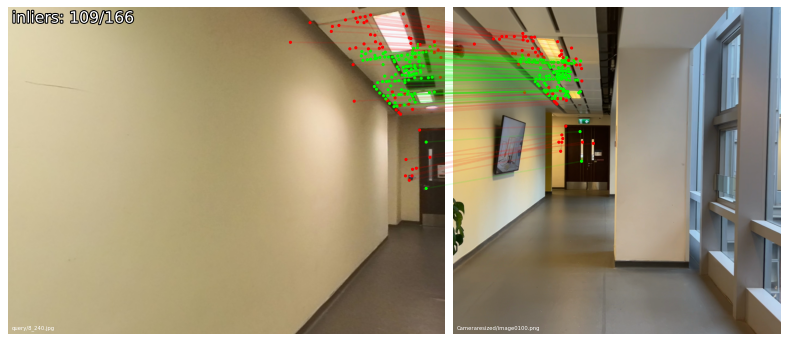

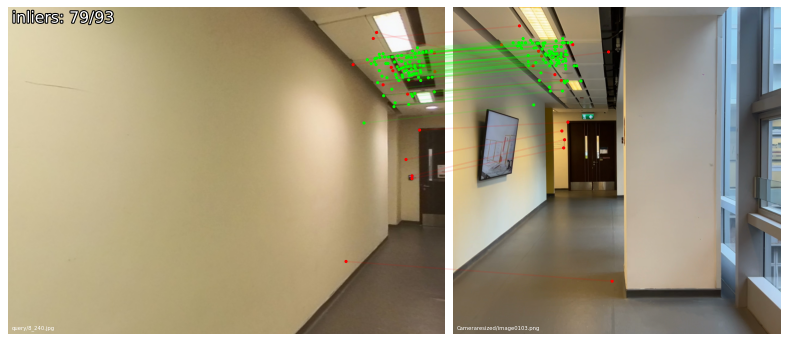

In [53]:
query = 'query/8_240.jpg'
!mkdir -p $images/query && wget $url -O $images/$query -q
# plot_images([read_image(images / query)], dpi=75)

references_registered = [model.images[i].name for i in model.reg_image_ids()]
extract_features.main(feature_conf, images, image_list=[query], feature_path=features, overwrite=True)
pairs_from_exhaustive.main(loc_pairs, image_list=[query], ref_list=references_registered)
match_features.main(matcher_conf, loc_pairs, features=features, matches=matches, overwrite=True);

import pycolmap
from hloc.localize_sfm import QueryLocalizer, pose_from_cluster

camera = pycolmap.infer_camera_from_image(images / query)
ref_ids = [model.find_image_with_name(n).image_id for n in references_registered]
conf = {
    'estimation': {'ransac': {'max_error': 12}},
    'refinement': {'refine_focal_length': True, 'refine_extra_params': True},
}
localizer = QueryLocalizer(model, conf)
ret, log = pose_from_cluster(localizer, query, camera, ref_ids, features, matches)

print(f'found {ret["num_inliers"]}/{len(ret["inliers"])} inlier correspondences.')
visualization.visualize_loc_from_log(images, query, log, model)

wget: missing URL
Usage: wget [OPTION]... [URL]...

Try `wget --help' for more options.


[2024/11/27 17:18:05 hloc INFO] Extracting local features with configuration:
{'model': {'max_keypoints': 5000, 'name': 'disk'},
 'output': 'feats-disk',
 'preprocessing': {'grayscale': False, 'resize_max': 1600}}


  0%|          | 0/1 [00:00<?, ?it/s]

[2024/11/27 17:18:06 hloc INFO] Finished exporting features.
[2024/11/27 17:18:06 hloc INFO] Found 273 pairs.
[2024/11/27 17:18:06 hloc INFO] Matching local features with configuration:
{'model': {'features': 'disk', 'name': 'lightglue'},
 'output': 'matches-disk-lightglue'}


  0%|          | 0/273 [00:00<?, ?it/s]

[2024/11/27 17:18:17 hloc INFO] Finished exporting matches.


found 290/2495 inlier correspondences.


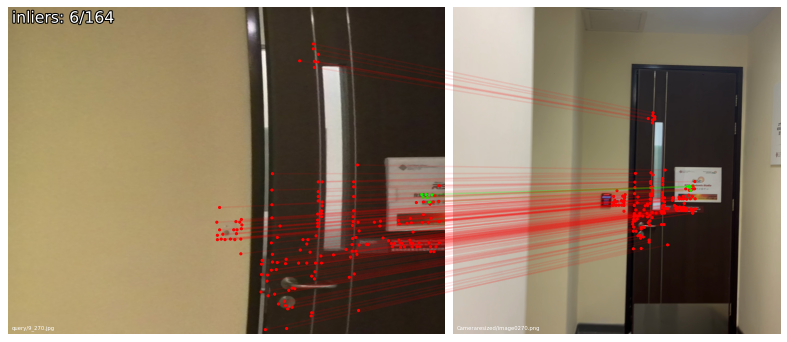

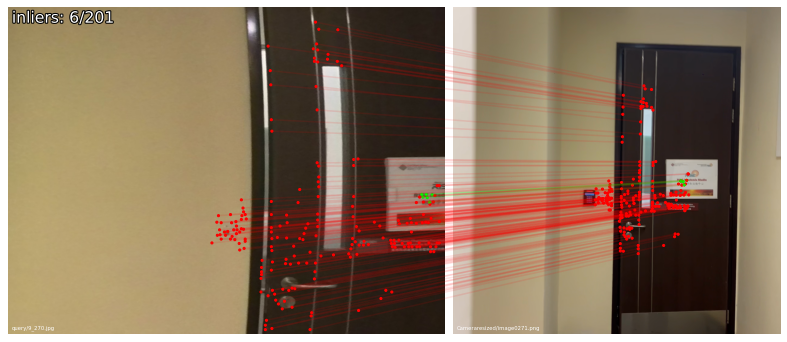

In [52]:
query = 'query/9_270.jpg'
!mkdir -p $images/query && wget $url -O $images/$query -q
# plot_images([read_image(images / query)], dpi=75)

references_registered = [model.images[i].name for i in model.reg_image_ids()]
extract_features.main(feature_conf, images, image_list=[query], feature_path=features, overwrite=True)
pairs_from_exhaustive.main(loc_pairs, image_list=[query], ref_list=references_registered)
match_features.main(matcher_conf, loc_pairs, features=features, matches=matches, overwrite=True);

import pycolmap
from hloc.localize_sfm import QueryLocalizer, pose_from_cluster

camera = pycolmap.infer_camera_from_image(images / query)
ref_ids = [model.find_image_with_name(n).image_id for n in references_registered]
conf = {
    'estimation': {'ransac': {'max_error': 12}},
    'refinement': {'refine_focal_length': True, 'refine_extra_params': True},
}
localizer = QueryLocalizer(model, conf)
ret, log = pose_from_cluster(localizer, query, camera, ref_ids, features, matches)

print(f'found {ret["num_inliers"]}/{len(ret["inliers"])} inlier correspondences.')
visualization.visualize_loc_from_log(images, query, log, model)

wget: missing URL
Usage: wget [OPTION]... [URL]...

Try `wget --help' for more options.


[2024/11/27 17:20:17 hloc INFO] Extracting local features with configuration:
{'model': {'max_keypoints': 5000, 'name': 'disk'},
 'output': 'feats-disk',
 'preprocessing': {'grayscale': False, 'resize_max': 1600}}


  0%|          | 0/1 [00:00<?, ?it/s]

[2024/11/27 17:20:17 hloc INFO] Finished exporting features.
[2024/11/27 17:20:17 hloc INFO] Found 273 pairs.
[2024/11/27 17:20:17 hloc INFO] Matching local features with configuration:
{'model': {'features': 'disk', 'name': 'lightglue'},
 'output': 'matches-disk-lightglue'}


  0%|          | 0/273 [00:00<?, ?it/s]

[2024/11/27 17:20:30 hloc INFO] Finished exporting matches.


found 1418/6578 inlier correspondences.


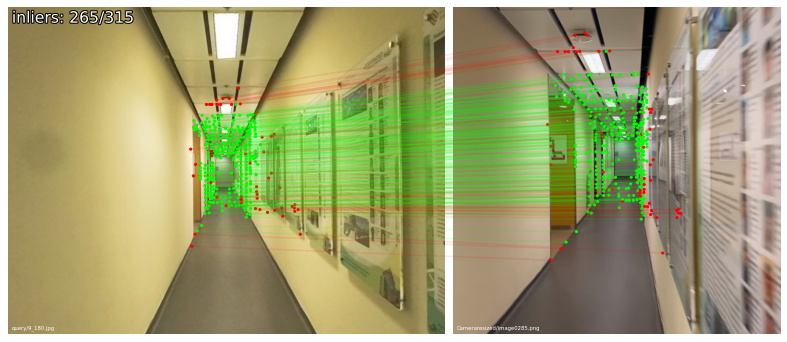

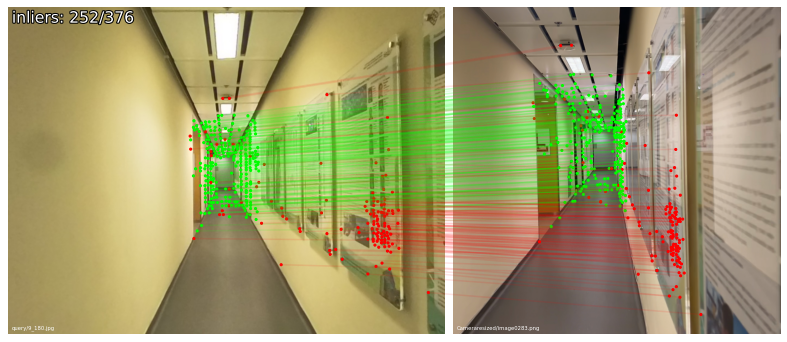

In [54]:
query = 'query/9_180.jpg'
!mkdir -p $images/query && wget $url -O $images/$query -q
# plot_images([read_image(images / query)], dpi=75)

references_registered = [model.images[i].name for i in model.reg_image_ids()]
extract_features.main(feature_conf, images, image_list=[query], feature_path=features, overwrite=True)
pairs_from_exhaustive.main(loc_pairs, image_list=[query], ref_list=references_registered)
match_features.main(matcher_conf, loc_pairs, features=features, matches=matches, overwrite=True);

import pycolmap
from hloc.localize_sfm import QueryLocalizer, pose_from_cluster

camera = pycolmap.infer_camera_from_image(images / query)
ref_ids = [model.find_image_with_name(n).image_id for n in references_registered]
conf = {
    'estimation': {'ransac': {'max_error': 12}},
    'refinement': {'refine_focal_length': True, 'refine_extra_params': True},
}
localizer = QueryLocalizer(model, conf)
ret, log = pose_from_cluster(localizer, query, camera, ref_ids, features, matches)

print(f'found {ret["num_inliers"]}/{len(ret["inliers"])} inlier correspondences.')
visualization.visualize_loc_from_log(images, query, log, model)

wget: missing URL
Usage: wget [OPTION]... [URL]...

Try `wget --help' for more options.


[2024/11/27 17:21:01 hloc INFO] Extracting local features with configuration:
{'model': {'max_keypoints': 5000, 'name': 'disk'},
 'output': 'feats-disk',
 'preprocessing': {'grayscale': False, 'resize_max': 1600}}


  0%|          | 0/1 [00:00<?, ?it/s]

[2024/11/27 17:21:02 hloc INFO] Finished exporting features.
[2024/11/27 17:21:02 hloc INFO] Found 273 pairs.
[2024/11/27 17:21:02 hloc INFO] Matching local features with configuration:
{'model': {'features': 'disk', 'name': 'lightglue'},
 'output': 'matches-disk-lightglue'}


  0%|          | 0/273 [00:00<?, ?it/s]

[2024/11/27 17:21:14 hloc INFO] Finished exporting matches.


found 1588/7613 inlier correspondences.


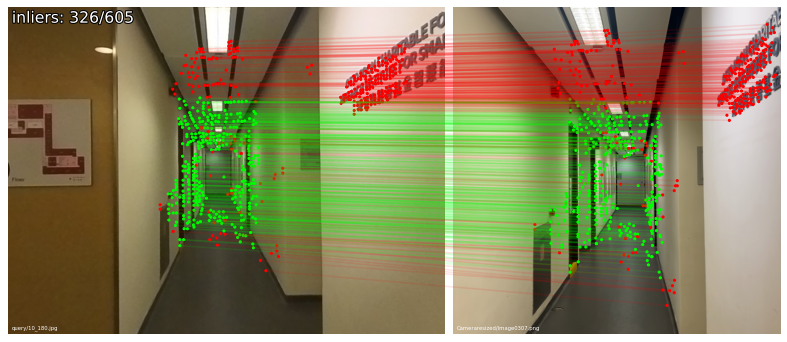

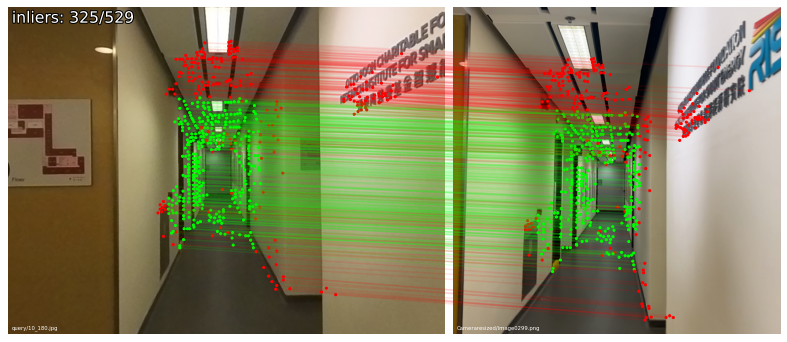

In [56]:
query = 'query/10_180.jpg'
!mkdir -p $images/query && wget $url -O $images/$query -q
# plot_images([read_image(images / query)], dpi=75)

references_registered = [model.images[i].name for i in model.reg_image_ids()]
extract_features.main(feature_conf, images, image_list=[query], feature_path=features, overwrite=True)
pairs_from_exhaustive.main(loc_pairs, image_list=[query], ref_list=references_registered)
match_features.main(matcher_conf, loc_pairs, features=features, matches=matches, overwrite=True);

import pycolmap
from hloc.localize_sfm import QueryLocalizer, pose_from_cluster

camera = pycolmap.infer_camera_from_image(images / query)
ref_ids = [model.find_image_with_name(n).image_id for n in references_registered]
conf = {
    'estimation': {'ransac': {'max_error': 12}},
    'refinement': {'refine_focal_length': True, 'refine_extra_params': True},
}
localizer = QueryLocalizer(model, conf)
ret, log = pose_from_cluster(localizer, query, camera, ref_ids, features, matches)

print(f'found {ret["num_inliers"]}/{len(ret["inliers"])} inlier correspondences.')
visualization.visualize_loc_from_log(images, query, log, model)